# Assignment | A Barcelona Case
**Computational Essay** | **Author:** Milda Sutkaityte

**Introduction**

This computational essay explores spatial patterns in Barcelona using openly accessible data and spatial analysis techniques. Following the structure of the final assignment, the analysis consists of two parts: **Socio-Spatial Patterns** and **Socio-Economic Dynamics**.

## Part One - Socio-Spatial Patterns

##### Libraries >

In [1]:
import esda
import geopandas as gpd
import matplotlib.pyplot as plt
import mgwr
import numpy as np
import pandas as pd
import seaborn as sns
import statsmodels.formula.api as sm
from libpysal import graph
from shapely import wkt
import contextily
import pointpats
from matplotlib import patches
from sklearn import cluster

# Additional libraries
import urllib.request
import requests

#### 1. Preparation of Social Data
In this part I download data reflecting two aspects (**gender and education**) of the population structure of the city at the level of census areas (Secció censal in Spanish). For this task I am using dataset named "Population aged 16 years old and over by by level of education and sex" (2024). Then I pivot the social data in a wide column format, so that rows become unique census areas and two-aspect social data become columns. This is necessary for later social and geometry data join.

##### Code >

In [2]:
population_url = (
    "https://opendata-ajuntament.barcelona.cat"
    "/data/en/dataset/pad_mdbas_niv-educa-esta_sexe"
    "/resource/072daedd-2816-4d49-9afb-7a7dee4d1741"
    "/download/2024_pad_mdbas_niv-educa-esta_sexe.csv"
)
population = pd.read_csv(population_url)

In [3]:
# Taking only the columns I need in the further analysis
pop = population[["Seccio_Censal", "NIV_EDUCA_esta", "SEXE", "Valor"]].copy()

# Changing "Valor" data type to int, if not int - stays empty
pop["Valor"] = pd.to_numeric(pop["Valor"], errors="coerce").astype("Int64")

In [4]:
# Social data meanings:
# Sexe 1 - Female, Sexe 2 - Male
# NIV_EDUCA_esta 1 - Less than primary education
# NIV_EDUCA_esta 2 - Primary education
# NIV_EDUCA_esta 3 - Lower secondary education
# NIV_EDUCA_esta 4 - Upper secondary or post-secondary non-tertiary education
# NIV_EDUCA_esta 5 - Tertiary education
# NIV_EDUCA_esta 6 - Not available

# Pivoting Social data:
# 1 row = 1 Seccio Censas
# Wide column format, thus 1 column = education_gender
pop_wide = (
    pop.pivot_table(
        index="Seccio_Censal",
        columns=["NIV_EDUCA_esta", "SEXE"],
        values="Valor",
        aggfunc="sum"   
    )
)
pop_wide.columns = [
    f"edu{edu}_sex{sex}" for (edu, sex) in pop_wide.columns
]
pop_wide = pop_wide.reset_index()
edu_cols = [col for col in pop_wide.columns if col.startswith("edu")]
pop_wide["pop_total"] = pop_wide[edu_cols].sum(axis=1)

#### 2. Preparation of Geometry Data
In this part I find relevant geometry. In this part I acctually struggled a lot, as the census area ID format in social data and in the geometry data was different. Thus, it took a while for me to realise, how to recreate the same ID format. 

> *Real Seccio Censal ID is created like: DDSSS, where DD is District number and SSS is Seccio number in that District. Thus, full formula is DISTRICTE * 1000 + SEC_CENS*

##### Code >

In [5]:
# ZIP URL from Open Data BCN (Unitats_Administratives_BCN)
geometry_url = (
    "https://opendata-ajuntament.barcelona.cat/data/dataset/"
    "808daafa-d9ce-48c0-925a-fa5afdb1ed41/resource/"
    "cd800462-f326-429f-a67a-c69b7fc4c50a/download"
)

# Avoiding the error about the certificates
response = requests.get(geometry_url, verify=False)
with open("Unitats_Administratives_BCN.zip", "wb") as f:
    f.write(response.content)

areas_all = gpd.read_file(
    "zip://Unitats_Administratives_BCN.zip!0301100100_UNITATS_ADM_POLIGONS.json"
)

C:\Users\milda\Documents\GitHub\spatial-data-science-in-python-mildasut\.pixi\envs\default\Lib\site-packages\urllib3\connectionpool.py:1097: InsecureRequestWarning: Unverified HTTPS request is being made to host 'opendata-ajuntament.barcelona.cat'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings
  warnings.warn(
C:\Users\milda\Documents\GitHub\spatial-data-science-in-python-mildasut\.pixi\envs\default\Lib\site-packages\urllib3\connectionpool.py:1097: InsecureRequestWarning: Unverified HTTPS request is being made to host 'w20.bcn.cat'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings
  warnings.warn(


In [6]:
# Taking only geometry that is of Seccio Censal
secc = areas_all[areas_all["TIPUS_UA"] == "SEC_CENS"].copy()

# Leaving only the columns I need for further analysis
secc = secc[["DISTRICTE", "SEC_CENS", "geometry"]].copy()

In [7]:
# Creating helper DISTRICTE ID column as int
secc["DISTRICTE_int"] = (
    secc["DISTRICTE"]
    .str.lstrip("0")
    .astype(int)
)
# Creating helper SEC_CENS ID column as int
secc["SEC_CENS_int"] = (
    secc["SEC_CENS"]
    .str.lstrip("0")
    .astype(int)
)
# Creating census ID column (DISTRICTE * 1000 + SEC_CENS)
secc["sec_id"] = secc["DISTRICTE_int"] * 1000 + secc["SEC_CENS_int"]

#### 3. Joining Socio-Spatial Data and Initial Spatial Exploration
In this part I merge the social dataset with the geometry and produce an initial visualisation of total population across census areas. 

##### Code >

In [8]:
gdf = secc.merge(
    pop_wide,
    left_on="sec_id",
    right_on="Seccio_Censal",
    how="left"
)

In [9]:
# Reprojecting coordinates to WGS84
gdf_wgs84 = gdf.to_crs(epsg=4326)

# General visualisation by total population
gdf_wgs84.explore(
    column="pop_total",        
    cmap="viridis_r",
    tiles="CartoDB Positron",
    prefer_canvas=True,
    legend=True,
    tooltip=["sec_id", "pop_total"]
)

##### *Map 1. Total Population in Census Areas of Barcelona*

The initial results revealed several extreme population outliers: a few areas exceed 3,000 residents, and one unit (ID 1026) surpasses 12,000—implausible for the size of these census zones. I first suspected a processing error, but repeating the procedure with a different social dataset produced identical results. This suggests the issue originates from the official data itself. A likely explanation is that some areas host central municipal registration addresses, where residents without a stable home are officially registered, inflating local counts. The largest outlier lies in the historic centre, which supports this interpretation. Although I tested normalisation and proportional downscaling, these approaches introduced unwanted distortions. Therefore, I chose to retain the original values and simply account for these outliers when interpreting results.

#### 4. Exploration of the Population Distribution by Education
In this step, I explore the spatial distribution of the population by education level. The original dataset contains 6 detailed categories of education levels, which I regroup into broader, analytically more meaningful groups: 
- **Non-tertiary education** – people with less than tertiary education (levels 1–4)
- **Tertiary education** – people with a higher education degree (level 5)
- **Not available** – cases where no information on education is reported (level 6)

##### Code >

In [10]:
# All education levels separated
edu1_cols = [c for c in gdf_wgs84.columns if c.startswith("edu1")]
edu2_cols = [c for c in gdf_wgs84.columns if c.startswith("edu2")]
edu3_cols = [c for c in gdf_wgs84.columns if c.startswith("edu3")]
edu4_cols = [c for c in gdf_wgs84.columns if c.startswith("edu4")]
edu5_cols = [c for c in gdf_wgs84.columns if c.startswith("edu5")]  # Tertiary
edu6_cols = [c for c in gdf_wgs84.columns if c.startswith("edu6")]  # Not available

# All education columns
all_edu_cols = edu1_cols + edu2_cols + edu3_cols + edu4_cols + edu5_cols + edu6_cols
gdf_wgs84[all_edu_cols] = gdf_wgs84[all_edu_cols].fillna(0)

# Education Category 1: Non-tertiary (edu1–edu4)
gdf_wgs84["edu_non_tertiary"] = gdf_wgs84[edu1_cols + edu2_cols + edu3_cols + edu4_cols].sum(axis=1)

# Education Category 2: Tertiary (edu5)
gdf_wgs84["edu_tertiary"] = gdf_wgs84[edu5_cols].sum(axis=1)

# Education Category 3: Not available (edu6)
gdf_wgs84["edu_na"] = gdf_wgs84[edu6_cols].sum(axis=1)

# Tertiary / All - Not available
gdf_wgs84["edu_known_total"] = gdf_wgs84["edu_non_tertiary"] + gdf_wgs84["edu_tertiary"]
gdf_wgs84["tertiary_share"] = np.where(
    gdf_wgs84["edu_known_total"] > 0,
    gdf_wgs84["edu_tertiary"] / gdf_wgs84["edu_known_total"],
    np.nan  
)

In [11]:
# Visualisation of tertiary share
gdf_wgs84.explore(
    column="tertiary_share",       
    cmap="PiYG",                 
    scheme="quantiles",            
    k=7,                           
    tiles="CartoDB Positron",
    prefer_canvas=True,
    legend=True,
    tooltip=[
        "sec_id",
        "edu_non_tertiary",
        "edu_tertiary",
        "edu_na",
        "edu_known_total",
        "tertiary_share"
    ],
    vmin=-1,
    vmax=1                         
)

##### *Map 2. Population Distribution by Tertiary vs Non-Tertiary Education*
This map reveals a clear and pronounced spatial pattern in educational distribution across Barcelona. Areas with a higher share of tertiary-educated residents are concentrated in the central part of the city, stretching from west to east. In contrast, neighbourhoods with lower educational levels are predominantly located in the southern and especially northern parts of the city. This division highlights a well-defined socio-spatial gradient, reflecting long-standing differences in urban development, housing structure, and socio-economic composition.

#### 5. Cheking Global Spatial Autorrelation
In this step, I construct a spatial weights matrix to describe how census areas relate to one another. Using queen contiguity, polygons are treated as neighbours if they touch at any point, which is suitable for Barcelona’s small and irregular census units.

After row-standardising the weights, I compute the spatial lag of tertiary share, representing the average educational level in each area’s neighbouring units. I then standardise both the original variable and its lag to prepare them for subsequent global autocorrelation analysis.

Finally, I classify areas into two groups (above and below the city mean of tertiary education).

##### Code >

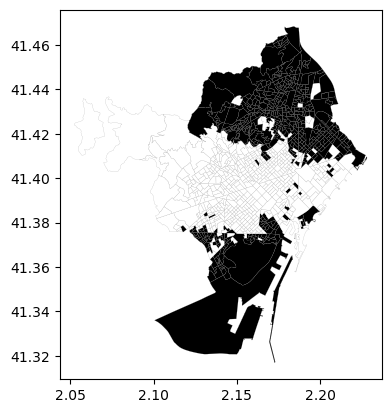

In [12]:
# Queen contiguity: polygons are neighbors if they share any boundary point
contiguity = graph.Graph.build_contiguity(gdf_wgs84, rook=False)

# Row standartization
contiguity_r = contiguity.transform("r")

# Spatial lag of tertiary_share
gdf_wgs84['tertiary_share_lag'] = contiguity_r.lag(gdf_wgs84["tertiary_share"])

# Standartized tertiary_share
gdf_wgs84["tertiary_share_std"] = (
    gdf_wgs84["tertiary_share"] - gdf_wgs84["tertiary_share"].mean()
) / gdf_wgs84["tertiary_share"].std()

# Standartized Spatial lag of tertiary_share
gdf_wgs84["tertiary_share_std_lag"] = contiguity_r.lag(gdf_wgs84["tertiary_share_std"])

# Create a binary variable from "tertiary_share" encoding areas with rank above city-wide mean
tertiary_share_mean = gdf_wgs84['tertiary_share'].mean()
gdf_wgs84["tertiary_share_low"] = (gdf_wgs84["tertiary_share"] < tertiary_share_mean).astype(int)

_ = gdf_wgs84.plot("tertiary_share_low", cmap="binary", linewidth=.1, edgecolor="grey")

##### *Map 3. High vs Low Tertiary Education Share*
This map reproduces the previously observed spatial pattern: a highly educated central corridor, expanding from east to west, and lower-education clusters in the northern and southern parts of the city.

Further, I test whether the observed spatial pattern is statistically significant. First, I compute the **Join Counts statistic**. The resulting value of **0.001** indicates a **highly significant** patterns.

Next, I perform a second test of global spatial dependence: **Moran’s I**. This approach does not rely on binary classification and therefore captures the full variation in tertiary_share.

##### Code >

In [13]:
# Measure Join Counts statistic on the new variable.
jc = esda.Join_Counts(
    gdf_wgs84["tertiary_share_low"],
    contiguity_r
)
jc.p_sim_bb

np.float64(0.001)

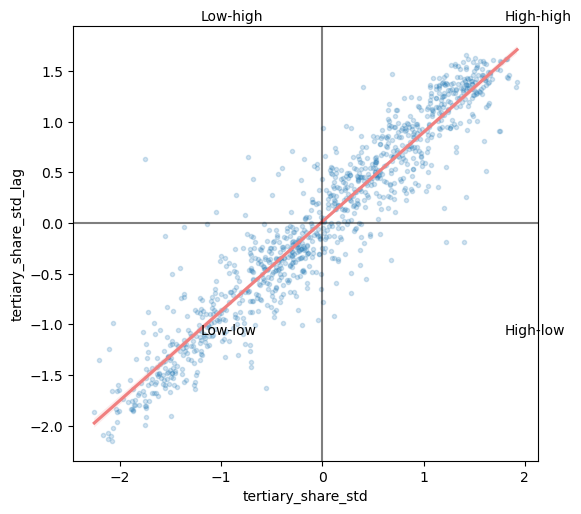

In [14]:
# Moran's I. Visualise the main "Rankv2" with a Moran Plot

f, ax = plt.subplots(1, figsize=(6, 6))
sns.regplot(
    x="tertiary_share_std", # standardized value. Standartization MUST be done BEFORE the lag
    y="tertiary_share_std_lag", # lag of that standardized value
    data=gdf_wgs84,
    marker=".",
    scatter_kws={"alpha": 0.2},
    line_kws=dict(color="lightcoral")
)
ax.set_aspect('equal') # show visually correct proportion
plt.axvline(0, c="black", alpha=0.5)
plt.axhline(0, c="black", alpha=0.5)
plt.text(1.8, 2, "High-high", fontsize=10)
plt.text(1.8, -1.1, "High-low", fontsize=10)
plt.text(-1.2, 2, "Low-high", fontsize=10)
plt.text(-1.2, -1.1, "Low-low", fontsize=10);

##### *Graph 1. Moran Plot of Tertiary Share*

A positive and significant **Moran’s I** confirms that census areas with high shares of tertiary-educated residents are spatially clustered, as are areas with low shares. The **Moran’s I** reaches **0.883**, which indicates an **extremely strong level of positive spatial autocorrelation**. The accompanying **simulated p-value (p = 0.001)** shows that this pattern is highly unlikely to arise by chance. In other words, the diagnostic results quantitatively validate what the maps already suggested: Barcelona’s educational landscape is characterised by a very pronounced clustering of similar areas, with a high-education central corridor and low-education zones in the north and south.

##### Code >

In [15]:
# Calculate Moran’s I
mi = esda.Moran(gdf_wgs84['tertiary_share'], contiguity_r) # Allways give the row standartized weight
mi.I

np.float64(0.8831237629920179)

In [16]:
mi.p_sim

np.float64(0.001)

#### 6. Checking Local Spatial Autocorrelation

To understand where exactly the clusters of educational attainment are located, I move from global to local measures of spatial autocorrelation.

Local Indicators of Spatial Association (LISA) allow me to identify specific census areas that contribute most to the global pattern. They distinguish between different types of spatial relationships and reveal whether these local clusters are statistically significant.

In this section, I create two maps that together provide a detailed view of local spatial structure. The **LISA Cluster Map of Tertiary Education** identifies the type and location of local clusters, while the **Significance of Local Education Clusters in Barcelona** highlights how statistically robust these clusters are. Taken together, these maps reveal not only where educational patterns emerge, but also which of them are meaningful and strongly supported by local spatial statistics.

##### Code >

In [17]:
# Creating LISA
lisa = esda.Moran_Local(gdf_wgs84['tertiary_share'], contiguity_r)
gdf_wgs84['cluster'] = lisa.get_cluster_labels(crit_value=0.05)

# Making a map of significant clusters at the 5%
lisa.explore(
  gdf_wgs84,
  crit_value=0.05,
  prefer_canvas=True,
  tiles="CartoDB Positron",
)

##### *Map 4. LISA Cluster Map of Tertiary Education*

This map shows statistically significant local clusters of educational attainment. **High–high clusters (hot spots)** indicates areas with high tertiary education surrounded by similarly high values. **Low–low clusters (cold spots)** mark neighbourhoods where both the area and its neighbours have low educational attainment. Outliers are shown in yellow (high–low) and cyan (low–high), highlighting areas that differ sharply from their immediate surroundings.

##### Code >

In [18]:
# Assign integer categories for significance
gdf_wgs84['sig_level'] = np.select(
    [
        lisa.p_sim < 0.01,
        (lisa.p_sim >= 0.01) & (lisa.p_sim < 0.05),
        (lisa.p_sim >= 0.05) & (lisa.p_sim < 0.1),
        lisa.p_sim >= 0.1
    ],
    [0.01, 0.05, 0.1, 0.11],
)

# Get sorted unique values of sig_level
unique_levels = sorted(gdf_wgs84['sig_level'].unique())  # [0,1,2,3]

# Define colors in the same order
colors = ["#0D3B66", "#4682B4", "#ADD8E6", "lightgray"]  # light → dark blue

# Create the map
gdf_wgs84.explore(
    column='sig_level',
    categorical=True,
    cmap=colors,       # pass a list of colors
    legend=True,
    alpha=0.7,
    linewidth=0.1,
    edgecolor="grey",
    tiles="CartoDB Positron",
    tooltip=["tertiary_share", "cluster"]
)

##### *Map 5. Significance of Local Education Clusters in Barcelona*
This map visualises the statistical significance of local spatial autocorrelation for tertiary share. The western–central corridor, as well as the northern and southern districts, appear in **dark and medium blue**, indicating **strong significance at the 1 % and 5 % levels**. These areas form the most robust clusters of educational attainment. In contrast, the transitional zones located between the central corridor and the northern or southern peripheries show weaker significance or none at all, suggesting more heterogeneous or unstable local patterns.

## Part Two - Socio-Economic Dynamics
In this part I will analyse the relationship between the price of Airbnb listings and social aspects of residents.

#### 1. Preparation and Visualisation of Airbnb Data 
In this part I download the Airbnb listings for Barcelona from Inside Airbnb and convert them into a GeoDataFrame. Since plotting individual points offers little analytical insight, I use two complementary visualisation techniques of **Hexbin representation** and **Kernel Density Estimation (KDE)**.

##### Code >

In [19]:
# Download and read the data
airbnb_url = (
    "http://data.insideairbnb.com/spain/catalonia/"
    "barcelona/2025-09-14/data/listings.csv.gz"
)
airbnb_df = pd.read_csv(airbnb_url)

# Convert to GeoDataFrame using lat/lng
airbnb_gdf = gpd.GeoDataFrame(
    airbnb_df,
    geometry=gpd.points_from_xy(airbnb_df.longitude, airbnb_df.latitude),
    crs="EPSG:4326"  # WGS84
)

# Reproject to S-JTSK / Krovak East North (EPSG:5514)
accidents = airbnb_gdf.to_crs(epsg=5514)

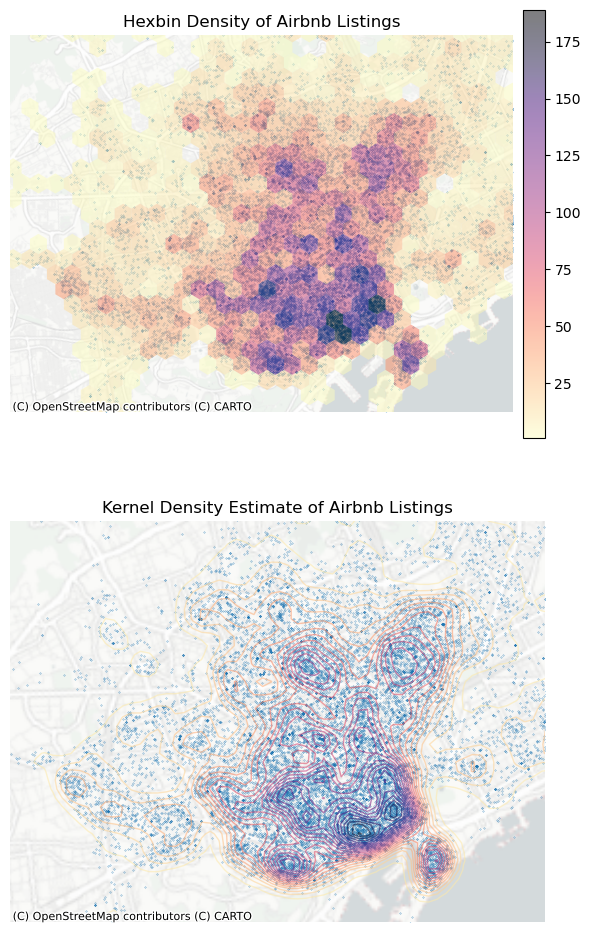

In [20]:
# Make sure we have x, y coordinates
accidents["x"] = accidents.geometry.x
accidents["y"] = accidents.geometry.y

# Create subplots
f, axs = plt.subplots(2, 1, figsize=(6, 10))

# 1) HEXBIN MAP
accidents.plot(ax=axs[0], markersize=0.05)

hb = axs[0].hexbin(
    accidents["x"],
    accidents["y"],
    gridsize=40,
    linewidths=0,
    alpha=0.5,
    cmap="magma_r",
    mincnt=1,
)

contextily.add_basemap(
    ax=axs[0],
    crs=accidents.crs,
    source="CartoDB Positron No Labels",
)

f.colorbar(hb, ax=axs[0], fraction=0.04, pad=0.02)

# 2) KDE MAP
accidents.plot(ax=axs[1], markersize=0.05)

pointpats.plot_density(
    accidents,
    bandwidth=150,
    levels=25,
    alpha=0.55,
    cmap="magma_r",
    linewidths=1,
    ax=axs[1],
)

contextily.add_basemap(
    ax=axs[1],
    crs=accidents.crs,
    source="CartoDB Positron No Labels",
)

axs[0].set_title("Hexbin Density of Airbnb Listings")
axs[1].set_title("Kernel Density Estimate of Airbnb Listings")
axs[0].set_xlim(-1891000, -1883000)
axs[1].set_xlim(-1891000, -1883000)
axs[0].set_ylim(-1786000, -1780000)
axs[1].set_ylim(-1786000, -1780000)
axs[0].set_axis_off()
axs[1].set_axis_off()

plt.tight_layout()

##### *Map 6. Hexbin and KDE Maps of Airbnb Listing Density*
Both maps show that Airbnb listings are strongly concentrated in Barcelona’s central districts, forming two main high-density clusters with smaller secondary peaks around them. The KDE surface provides a smoother view of these patterns, showing how intensity gradually spreads outward from the core areas and revealing broader spatial gradients across the city.

#### 2. Joining Socio-Spatial Data with Airbnb Data
In this step I link individual Airbnb listings to the census polygons using a spatial join. After cleaning the price field and converting it to a numeric format, I aggregate the listings by census area. For each polygon, I compute two indicators: **the average Airbnb price** and the **total number of listings**. Next, I merge the aggregated Airbnb statistics with the socio-demographic dataset using sec_id as the key.

##### Code >

In [21]:
# Spatial join Airbnb to polygons
airbnb_gdf = gpd.GeoDataFrame(
    airbnb_df,
    geometry=gpd.points_from_xy(airbnb_df.longitude, airbnb_df.latitude),
    crs="EPSG:4326"
)

# Spatial join
airbnb_joined = gpd.sjoin(airbnb_gdf, gdf_wgs84, how="left", predicate="within")

# Clean price column: "$123.00" → 123.0
airbnb_joined["price_clean"] = (
    airbnb_joined["price"]
    .str.replace("$","", regex=False)
    .str.replace(",","", regex=False)
    .astype(float)
)

# Aggregate: mean price + count
airbnb_poly_stats = (
    airbnb_joined.groupby("sec_id")
    .agg(
        avg_airbnb_price=("price_clean","mean"),
        airbnb_count=("id","count")
    )
    .reset_index()
)

In [22]:
# Join with Social data
gdf_merged = gdf_wgs84.merge(airbnb_poly_stats, on="sec_id", how="left")

# Replace NA (polygons with no listings)
gdf_merged["avg_airbnb_price"] = gdf_merged["avg_airbnb_price"].fillna(0)
gdf_merged["airbnb_count"] = gdf_merged["airbnb_count"].fillna(0)

#### 3. Low-Education Concentration Index (LECI)
To assess whether Airbnb’s economic activity tends to concentrate in less-educated neighbourhoods, I invent and compute the Low-Education Concentration Index (LECI). First, I calculate the share of residents with non-tertiary education. I then combine this with the average Airbnb price to create an index that reflects how much Airbnb economic value overlaps with low-education areas. This measure could help to answer whether more affordable, less privileged districts are becoming disproportionately targeted by short-term rental activity and tourism pressure.

##### Code >

In [23]:
# Creating the LECI
gdf_merged["non_tertiary_share"] = (
    gdf_merged["edu_non_tertiary"] / gdf_merged["pop_total"]
)

gdf_merged["LECI"] = (
    gdf_merged["avg_airbnb_price"] * gdf_merged["non_tertiary_share"]
)

In [24]:
# Visualisation of LECI
gdf_merged.explore(
    column="LECI",                  # my LECI index
    cmap="plasma_r",                  # sequential colormap for 0+ values
    scheme="quantiles",             # better contrast across the range
    k=7,                            # number of classes
    legend=True,
    tiles="CartoDB Positron",
    prefer_canvas=True,
    tooltip=[
        "sec_id",
        "pop_total",
        "airbnb_count",
        "edu_non_tertiary", 
        "LECI", # avg_airbnb_price * non_tertiary_share
        "non_tertiary_share", # Proportion of population without tertial education vs with
        "avg_airbnb_price", 
    ],
    style_kwds={
        "stroke": False             # no polygon borders for cleaner look
    },
)

##### *Map 7. Low-Education Concentration Index*
This choropleth map visualises the Low-Education Concentration Index (LECI). **Dark purple areas** represent the **highest LECI values**, indicating neighbourhoods where **higher Airbnb prices** strongly overlap with a larger share of **residents without tertiary education**. These zones may face greater socio-economic vulnerability due to the combined pressure of low educational attainment and intensive short-term rental activity.

**This map does not reveal any clear spatial pattern suggesting that LECI is meaningfully related to location.** The index appears scattered across the city without forming identifiable clusters, indicating that the overlap between Airbnb economic activity and low-education populations is not strongly structured by geography.

#### 4. Non-Spatial Linear Regression

As the spatial relationship between Airbnb prices and the share of tertiary-educated residents did not show meaningful patterns, I shifted the approach and examined how the number of Airbnb listings relates to the social characteristics of each census area.

In this step, I run a simple linear regression where the dependent variable is the **count of Airbnb listings** in each polygon. To capture key socio-demographic attributes, I compute two explanatory variables: the **share of residents with tertiary education** and the **share of women** in the population. 

##### Code >

In [25]:
# Share of residents with tertiary education
for i in range(1, 6):
    gdf_merged[f"edu{i}"] = (
        gdf_merged[f"edu{i}_sex1"] + gdf_merged[f"edu{i}_sex2"]
    )
gdf_merged["edu_tertiary_count"] = gdf_merged["edu5"]
gdf_merged["tertiary_share"] = gdf_merged["edu_tertiary_count"] / gdf_merged["pop_total"]

# Share of women in the total population
female_cols = [
    col for col in gdf_merged.columns
    if col.startswith("edu") and col.endswith("_sex1")
]
gdf_merged["pop_female"] = gdf_merged[female_cols].sum(axis=1)
gdf_merged["female_share"] = gdf_merged["pop_female"] / gdf_merged["pop_total"]

# Dependent and independent variables
dependent_var = "airbnb_count"
independent_vars = ["tertiary_share", "female_share"]

# OLS
formula = dependent_var + " ~ " + " + ".join(independent_vars)
ols = sm.ols(formula, data=gdf_merged).fit()
ols.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:           airbnb_count   R-squared:                       0.280
Model:                            OLS   Adj. R-squared:                  0.278
Method:                 Least Squares   F-statistic:                     206.7
Date:                Mon, 17 Nov 2025   Prob (F-statistic):           1.45e-76
Time:                        00:01:22   Log-Likelihood:                -4945.1
No. Observations:                1068   AIC:                             9896.
Df Residuals:                    1065   BIC:                             9911.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept        238.2176     16.309     14.607      0.000     206.217     270.218
tertiary_share    98.3740      5.773     17.039      0.000      87.046     109.702
female_share    -479.7519     31.333    -15.312      0.000    -541.233    -418.271
==============================================================================
Omnibus:                      906.727   Durbin-Watson:                   2.100
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            35984.233
Skew:                           3.669   Prob(JB):                         0.00
Kurtosis:                      30.473   Cond. No.                         55.4
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

##### *Table 1: OLS Results of Airbnb Listings on Social Indicators*

The regression shows that both social variables have a statistically significant relationship with the number of Airbnb listings.

- **Tertiary_share has a strong positive effect:**
Census areas with a larger proportion of tertiary-educated residents tend to have more Airbnb listings. 

- **Female_share has a strong negative effect:**
Areas with a higher proportion of women tend to have fewer Airbnb listings. 

Overall, **the model explains about 28 % of the variation in Airbnb listing counts**, indicating a meaningful but not exhaustive relationship between Airbnb presence and the social composition of neighbourhoods.

#### 2. Spatial exploration of the model (hidden structures)

To evaluate how well the regression captures the geography of Airbnb activity, I map both the predicted and actual listing counts. 

##### Code >

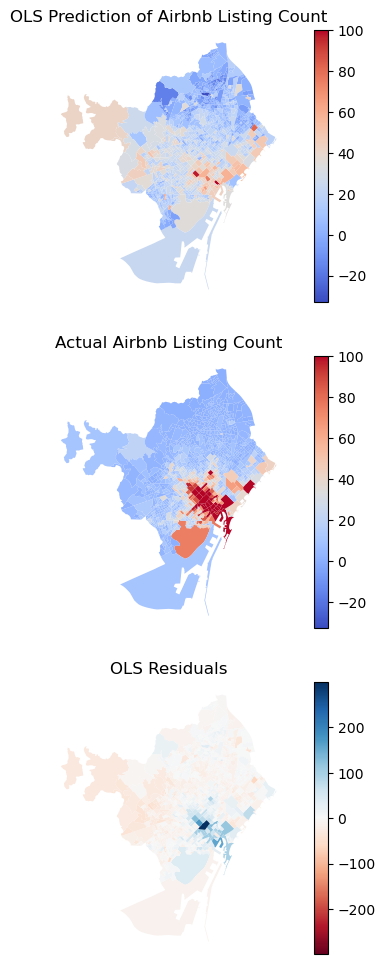

In [26]:
# Predict Airbnb listing counts using the fitted OLS model
predicted = ols.predict(gdf_merged)

# Create three subplots: predicted vs actual vs residuals
f, axs = plt.subplots(3, 1, figsize=(7, 12))

# Shared min/max range for fair comparison of counts
vmin = min(predicted.min(), gdf_merged["airbnb_count"].min())
vmax = max(predicted.max(), gdf_merged["airbnb_count"].max())

# OLS prediction map
gdf_merged.plot(
    predicted,
    legend=True,
    cmap="coolwarm",
    vmin=vmin,
    vmax=100,
    ax=axs[0],
)

# Actual Airbnb listing counts
gdf_merged.plot(
    "airbnb_count",
    legend=True,
    cmap="coolwarm",
    vmin=vmin,
    vmax=100,
    ax=axs[1],
)

# OLS Residuals
gdf_merged["residual"] = ols.resid
max_residual = gdf_merged["residual"].abs().max()
gdf_merged.plot(
    "residual",
    legend=True,
    cmap="RdBu",
    vmin=-max_residual,
    vmax=max_residual,
    ax=axs[2],
)

axs[0].set_title("OLS Prediction of Airbnb Listing Count")
axs[1].set_title("Actual Airbnb Listing Count")
axs[2].set_title("OLS Residuals")
axs[0].set_axis_off()
axs[1].set_axis_off()
axs[2].set_axis_off()

##### *Map 8. Visual Comparison Between OLS Prediction and Actual Data*

The model successfully reproduces the broad pattern of high Airbnb intensity in the central city areas and lower values in the surrounding neighbourhoods. However, it fails to capture finer spatial variations, thus, more nuansed spatial structures remain unexplained.

Further I test whether the OLS residuals still contain spatial structure. I compute the spatial lag of the residuals and plot them against the original residuals in a **Moran-style scatterplot**. 

##### Code >

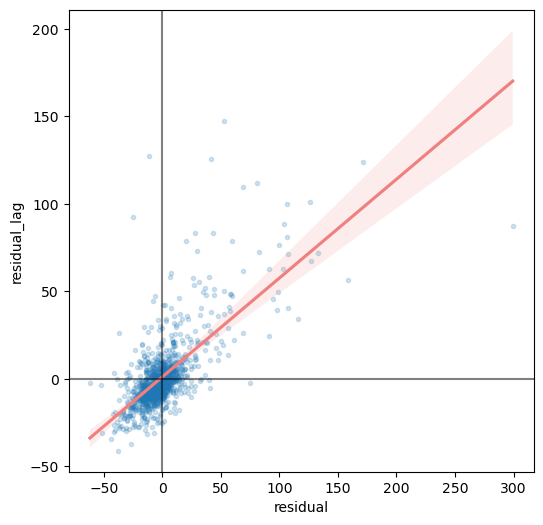

In [27]:
contiguity_r = graph.Graph.build_contiguity(gdf_merged).transform("r")

gdf_merged["residual_lag"] = contiguity_r.lag(gdf_merged["residual"])

f, ax = plt.subplots(1, figsize=(6, 6))
sns.regplot(
    x="residual",
    y="residual_lag",
    data=gdf_merged,
    marker=".",
    scatter_kws={"alpha": 0.2},
    line_kws=dict(color="lightcoral")
)
plt.axvline(0, c="black", alpha=0.5)
plt.axhline(0, c="black", alpha=0.5);

##### *Graph 2. Spatial Autocorrelation of OLS Residuals*

The upward-raising red line shows a clear positive relationship between residuals and their spatially lagged values. This indicates that areas with high residuals tend to be located near other high-residual areas (and likewise for low values). In other words, the residuals are spatially clustered, confirming that non-spatial OLS model does not fully capture the geographic structure of Airbnb activity.

In [28]:
# Converting coordinates to projected CRS (meters) for GWR
gdf_crs = gdf_merged.to_crs(epsg=25831).copy()

# Coordinates: centroids of polygons (for GWR kernel)
coords = gdf_crs.centroid.get_coordinates().values

# Dependent variable: Airbnb count
y = gdf_merged["airbnb_count"].astype(float).values.reshape(-1, 1)

# Independent variables: tertiary education and female share
independent_names = ["tertiary_share", "female_share"]
X = gdf_merged[independent_names].astype(float).values

# Optimal bandwidth
sel_bw = mgwr.sel_bw.Sel_BW(coords, y, X, fixed=True)
bw = sel_bw.search()

# GWR Model
fixed_bandwidth = mgwr.gwr.GWR(
    coords, y, X, bw=bw, fixed=True, name_x=independent_names
)
results = fixed_bandwidth.fit()
results.summary()

Model type                                                         Gaussian
Number of observations:                                                1068
Number of covariates:                                                     3

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                         657485.674
Log-likelihood:                                                   -4945.114
AIC:                                                               9896.227
AICc:                                                              9898.265
BIC:                                                             650058.851
R2:                                                                   0.280
Adj. R2:                                                              0.278

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- ---------- ------

##### *Table 2. Results of GWR*
The GWR model performs much better than the global OLS - **Adjusted R² increases from 0.28 to 0.84**, showing that the relationship between Airbnb activity and the social structure of districts is strongly spatially heterogeneous. The effects of tertiary education and the female share remain relevant, but their influence changes significantly across neighbourhoods, meaning that **geographical location plays a much stronger role than analysed social aspects of the residents**.

##### Code >

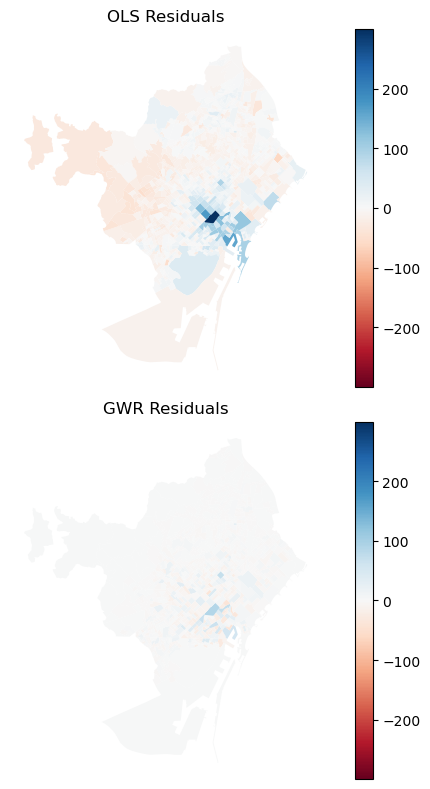

In [29]:
# 1) Compute comparable residual ranges
ols_resid = ols.resid
gwr_resid = results.resid_response.flatten()

max_resid = max(abs(ols_resid).max(), abs(gwr_resid).max())

# 2) Add residuals to the GeoDataFrame
gdf_plot = gdf_merged.copy()
gdf_plot["ols_residual"] = ols_resid
gdf_plot["gwr_residual"] = gwr_resid

# 3) Plot OLS vs GWR residual maps
f, axs = plt.subplots(2, 1, figsize=(7, 8))

gdf_plot.plot(
    "ols_residual",
    legend=True,
    cmap="RdBu",
    vmin=-max_resid,
    vmax=max_resid,
    ax=axs[0],
)
axs[0].set_title("OLS Residuals")
axs[0].set_axis_off()

gdf_plot.plot(
    "gwr_residual",
    legend=True,
    cmap="RdBu",
    vmin=-max_resid,
    vmax=max_resid,
    ax=axs[1],
)
axs[1].set_title("GWR Residuals")
axs[1].set_axis_off()

plt.tight_layout()

##### Map 9. OLS vs GWR Residuals
The residual maps show a clear improvement when moving from the global OLS model to the GWR model. OLS residuals form strong spatial clusters, while GWR residuals are more evenly distributed and notably smoother, indicating that the GWR model captures spatial variation more effectively and reduces systematic bias.

Lastly, I assess the local significance of the GWR coefficients by mapping the areas where the effects of tertiary education and the female share are statistically significant. These maps highlight the specific locations in which each variable meaningfully contributes to explaining Airbnb activity.

##### Code >

Critical t (95 %) 3.4815231053491873


C:\Users\milda\Documents\GitHub\spatial-data-science-in-python-mildasut\.pixi\envs\default\Lib\site-packages\spglm\base.py:254: RuntimeWarning: invalid value encountered in divide
  return self.params / self.bse


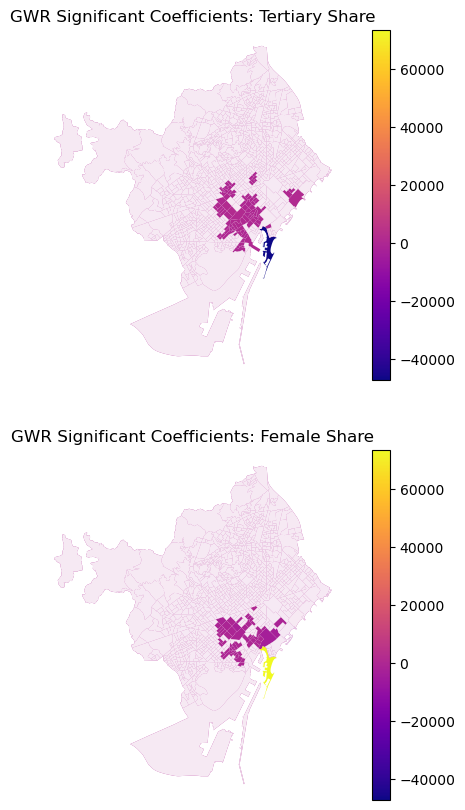

In [30]:
sig95 = results.adj_alpha[1]
critical_t = results.critical_tval(alpha=sig95)
print(f"Critical t (95 %) {critical_t}")

# Tertiary_share
sign_tertiary = np.abs(results.tvalues[:, 1]) > critical_t
coef_tertiary = results.params[:, 1]

# Female_share
sign_female = np.abs(results.tvalues[:, 2]) > critical_t
coef_female = results.params[:, 2]

# Common color scale
vmin = min(coef_tertiary.min(), coef_female.min())
vmax = max(coef_tertiary.max(), coef_female.max())

# Plot
f, axs = plt.subplots(2, 1, figsize=(7, 10))

# Tertiary_share map
gdf_merged.plot(coef_tertiary, cmap="plasma", legend=True, vmin=vmin, vmax=vmax, ax=axs[0])
gdf_merged[~sign_tertiary].plot(color="white", ax=axs[0], alpha=0.9)

# Female_share map
gdf_merged.plot(coef_female, cmap="plasma", legend=True, vmin=vmin, vmax=vmax, ax=axs[1])
gdf_merged[~sign_female].plot(color="white", ax=axs[1], alpha=0.9)

axs[0].set_title("GWR Significant Coefficients: Tertiary Share")
axs[1].set_title("GWR Significant Coefficients: Female Share")
axs[0].set_axis_off()
axs[1].set_axis_off()

##### *Map 10. GWR Significance for Education and Gender*
The adjusted critical **t-value is 3.48**, which indicates the threshold for statistical significance at the local level. Both maps show that significant effects concentrate in central Barcelona. For tertiary education, the relationship becomes negative in the port area, while the effect of the female share shows the opposite pattern, exhibiting positive significance in the same zone.